<a href="https://colab.research.google.com/github/Akhilesh-K-Yadav/First-Principles-of-Computer-Vision/blob/main/SIFT-Feature-Extraction/SIFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [20]:
import cv2
import numpy as np
import pickle
import argparse
import os
from time import time

In [21]:
!ls -lh "/content/fountain-P11.zip"

-rw-r--r-- 1 root root 32M May 31 09:21 /content/fountain-P11.zip


In [ ]:
mkdir "/content/data"

In [ ]:
!unzip "/content/fountain-P11.zip" -d "/content/data/"

Archive:  /content/fountain-P11.zip
   creating: /content/data/fountain-P11/
   creating: /content/data/fountain-P11/gt_dense_cameras/
  inflating: /content/data/fountain-P11/gt_dense_cameras/0000.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0001.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0002.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0003.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0004.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0005.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0006.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0007.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0008.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0009.jpg.camera  
  inflating: /content/data/fountain-P11/gt_dense_cameras/0010.jpg.camera  
   creating: /content/data/fountain-P11/

In [22]:
dir_path = "/content/data/fountain-P11/images/"

file_names = []
for file in os.listdir(dir_path):
  file_names.append(dir_path+file)
file_names.sort()


In [23]:
file_names

['/content/data/fountain-P11/images/0000.jpg',
 '/content/data/fountain-P11/images/0001.jpg',
 '/content/data/fountain-P11/images/0002.jpg',
 '/content/data/fountain-P11/images/0003.jpg',
 '/content/data/fountain-P11/images/0004.jpg',
 '/content/data/fountain-P11/images/0005.jpg',
 '/content/data/fountain-P11/images/0006.jpg',
 '/content/data/fountain-P11/images/0007.jpg',
 '/content/data/fountain-P11/images/0008.jpg',
 '/content/data/fountain-P11/images/0009.jpg',
 '/content/data/fountain-P11/images/0010.jpg',
 '/content/data/fountain-P11/images/K.txt']

In [54]:
from google.colab.patches import cv2_imshow

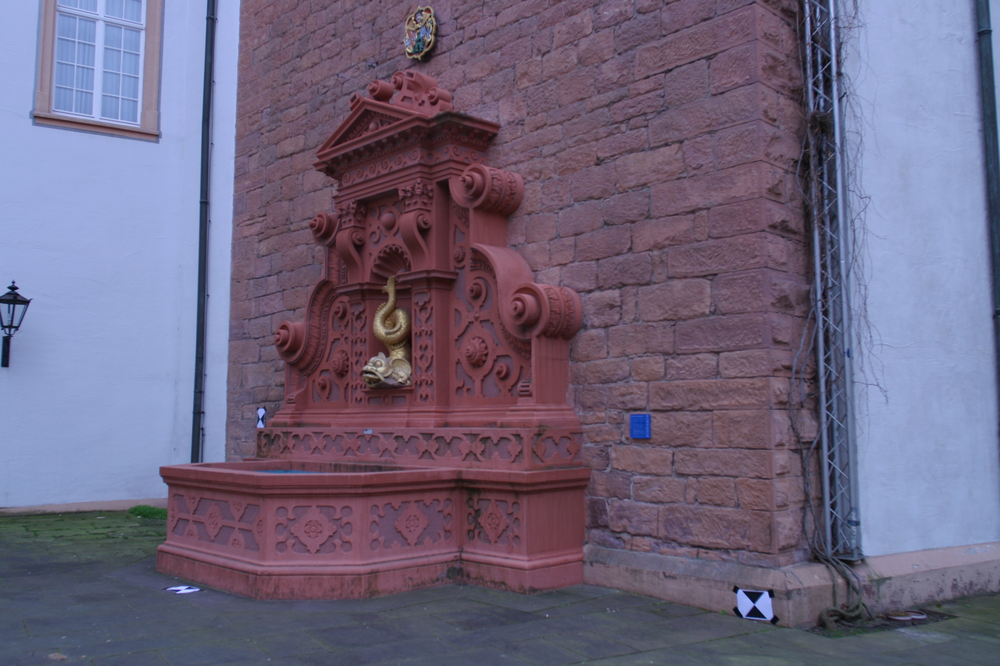

(2048, 3072, 3)

In [26]:
img = cv2.imread(file_names[0])
cv2_imshow(img)
img.shape

In [27]:
img = img[:,:,::-1]

In [28]:
feats = cv2.SIFT_create()
kp, desc = feats.detectAndCompute(img,None)

In [29]:
type(kp), type(desc)

(tuple, numpy.ndarray)

In [30]:
kp[0], len(kp), desc.shape

(< cv2.KeyPoint 0x7a972c9834e0>, 3870, (3870, 128))

In [31]:
img_out=cv2.drawKeypoints(img,kp,0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints.jpg',img_out)

True

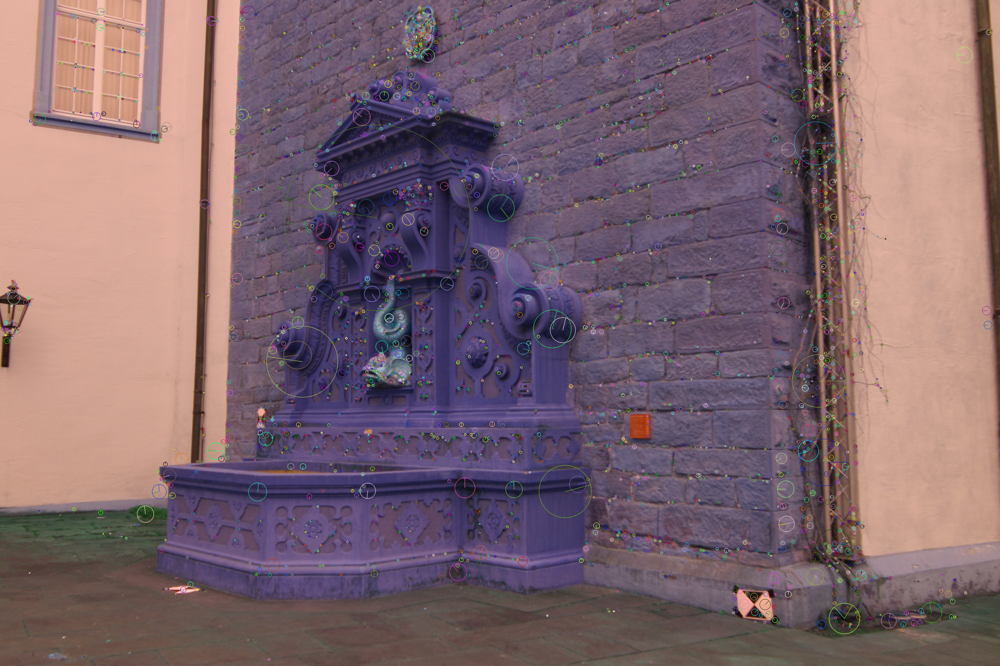

In [ ]:
cv2_imshow(img_out)

(3798, 128)


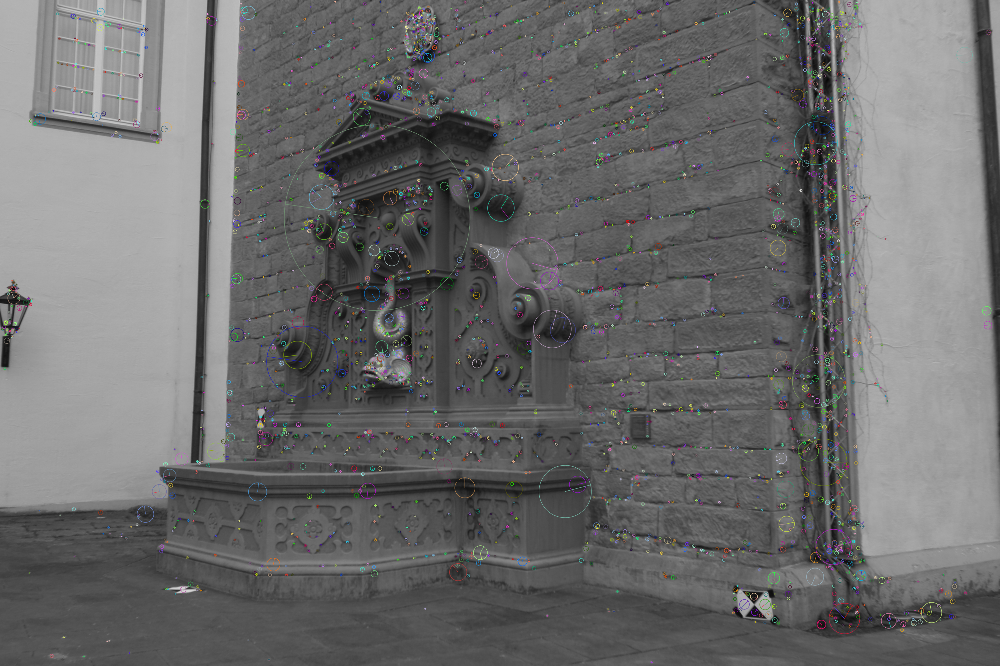

In [32]:
img_g = cv2.imread(file_names[0])
imagegray = cv2.cvtColor(img_g, cv2.COLOR_BGR2GRAY)
gray_feats = cv2.SIFT_create()
g_kp, g_desc = gray_feats.detectAndCompute(imagegray,None)
print(g_desc.shape)
img_out2=cv2.drawKeypoints(imagegray,kp,0,flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('sift_keypoints_gray.jpg',img_out2)
#cv2_imshow(imagegray)
cv2_imshow(img_out2)

#               ***Grayscaling improves feature detection***

In [33]:
img_g2 = cv2.imread(file_names[1])
imagegray2 = cv2.cvtColor(img_g2, cv2.COLOR_BGR2GRAY)
gray_feats = cv2.SIFT_create()
g_kp2, g_desc2 = gray_feats.detectAndCompute(imagegray2,None)
print(g_desc2.shape)


(4405, 128)


In [35]:
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=100)
flann = cv2.FlannBasedMatcher(index_params,search_params)
matches = flann.knnMatch(g_desc, g_desc2,k=2)

In [36]:
print(len(matches))

3798


In [57]:
good = []

for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        good.append([m])

In [58]:
print(len(good))

1468


In [59]:
flann_matches = cv2.drawMatchesKnn(imagegray, g_kp, imagegray2, g_kp2, good, None, flags=2)

In [60]:
cv2.imwrite('sift_matches.jpg',flann_matches)

True

In [61]:
import matplotlib.pyplot as plt

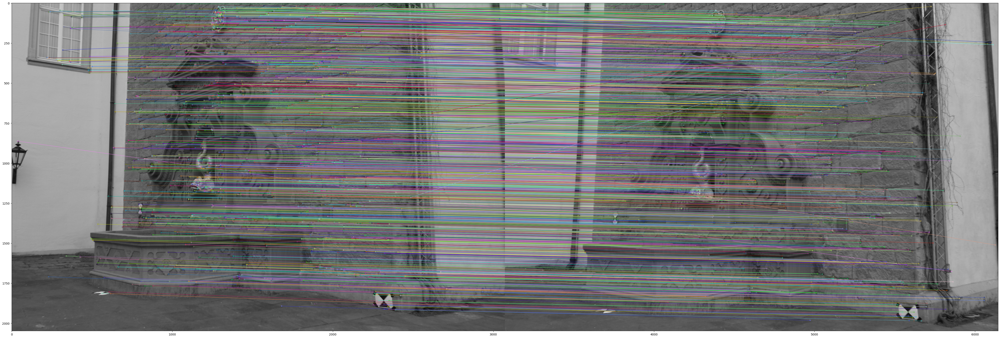

In [62]:
plt.figure(figsize=(60, 40))
plt.imshow(flann_matches)